In [1]:
from PIL import Image, ImageDraw
from IPython.display import display
from tqdm.notebook import tqdm

In [2]:
insert_size = 128
border = 2

scenes = ['car', 'chess', 'dragon', 'sponza']

resolutions = ['12x140', '24x280', '36x420', '48x560']

depths = ['near', 'mid', 'far']
colors = ['#2ca02c', '#1f77b4', '#ff7f0e']

methods = ['known', 'unknown']

iters = [1, 5, 10, 15, 20, 30, 40, 50]

n_scenes = len(scenes)
n_resolutions = len(resolutions)
n_depths = len(depths)
n_methods = len(methods)
n_iters = len(iters)

coords = [[(355, 615), (567, 210), (770, 390)],
          [(473, 455), (660, 315), (300, 370)],
          [(350, 360), (535, 540), (540, 385)],
          [(75, 675), (440, 598), (490, 450)]]

In [3]:
inserts = []

with tqdm(total=n_scenes * n_resolutions * n_depths * n_methods * n_iters) as pbar:
    for scene_index in range(n_scenes):
        inserts.append([])
        for resolution_index in range(n_resolutions):
            inserts[scene_index].append([])
            for depth_index in range(n_depths):
                inserts[scene_index][resolution_index].append([])
                for method_index in range(n_methods):
                    inserts[scene_index][resolution_index][depth_index].append([])
                    for iter_index in range(n_iters):
                        with Image.open('figures/multiter/{}-{}-{}-{}-i{}.png'.format(scenes[scene_index], resolutions[resolution_index], depths[depth_index], methods[method_index], iters[iter_index])) as img:
                            x, y = coords[scene_index][depth_index]
                            insert = img.crop((x, y, x + insert_size, y + insert_size))
                            inserts[scene_index][resolution_index][depth_index][method_index].append(insert)

                            ImageDraw.Draw(insert).rectangle((0, 0, insert_size - 1, insert_size - 1), outline=colors[depth_index], width=border)
                            pbar.update()

  0%|          | 0/768 [00:00<?, ?it/s]

Rows: Resolution | Columns: Iterations


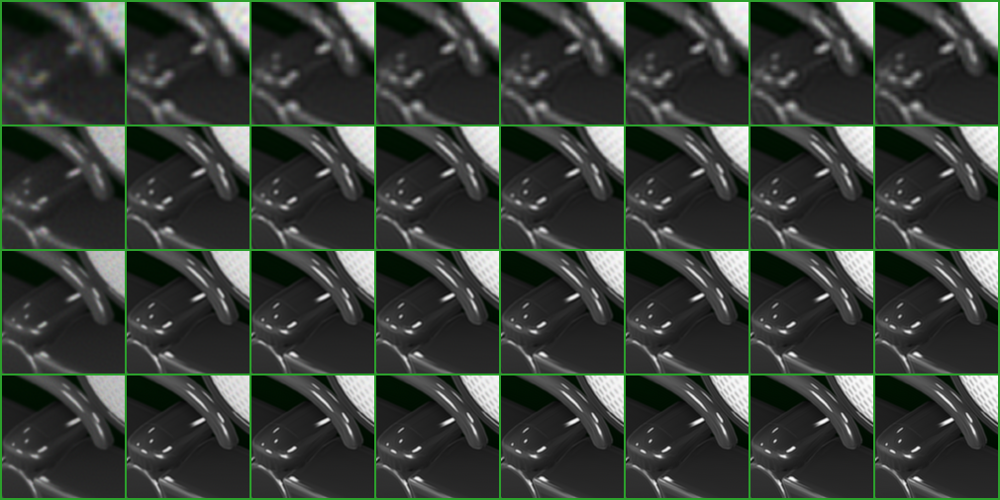

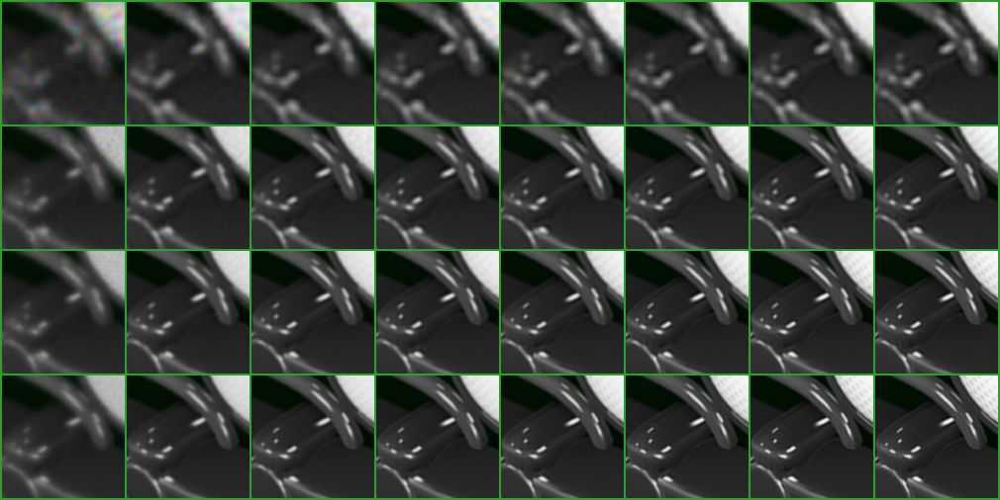

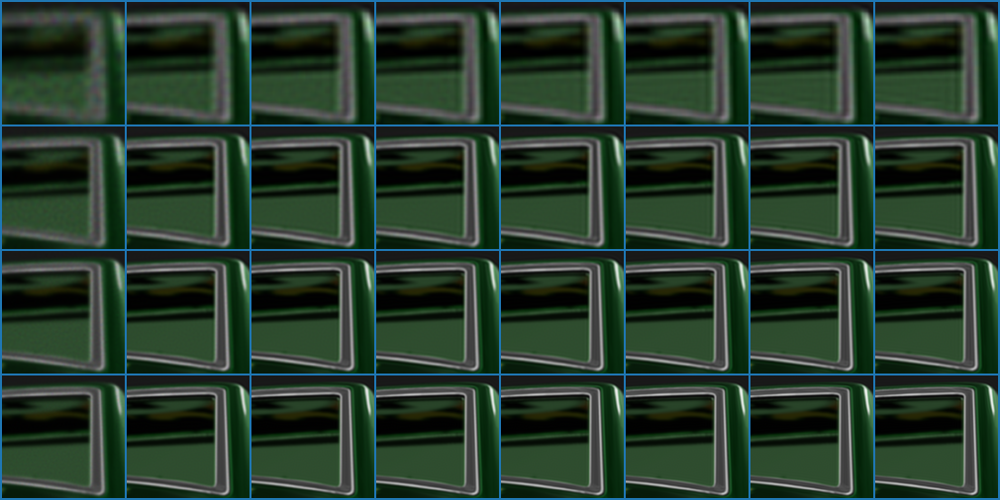

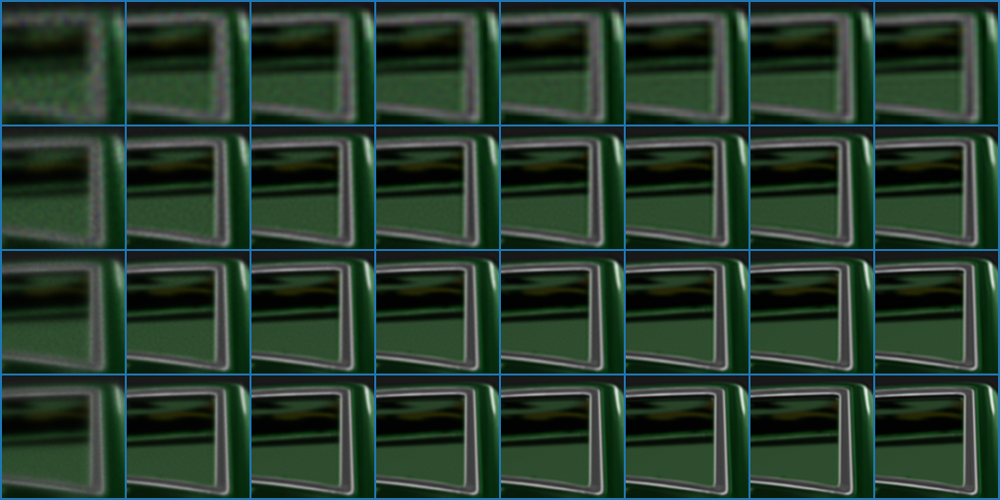

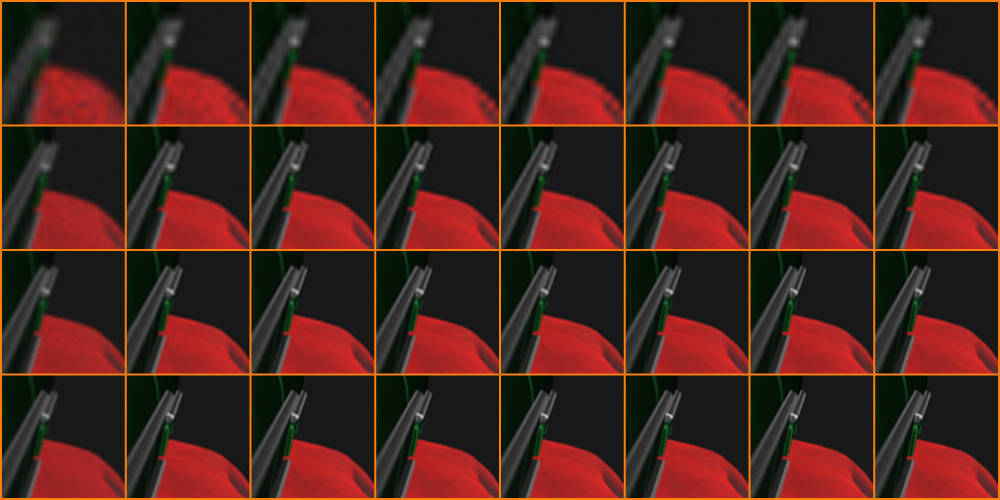

...

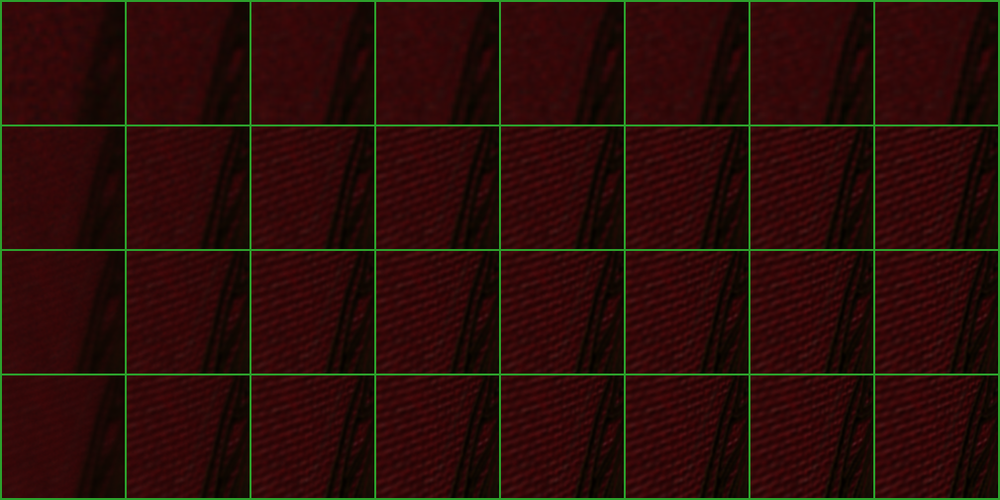

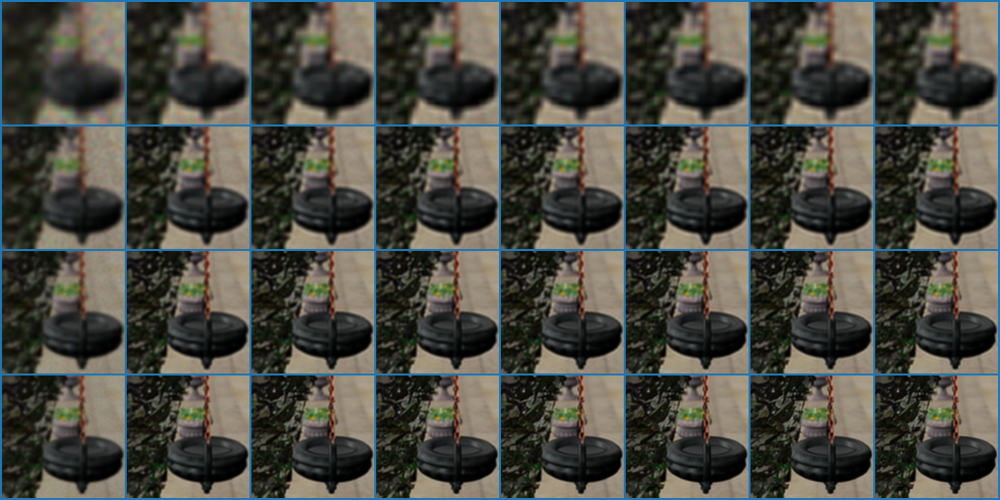

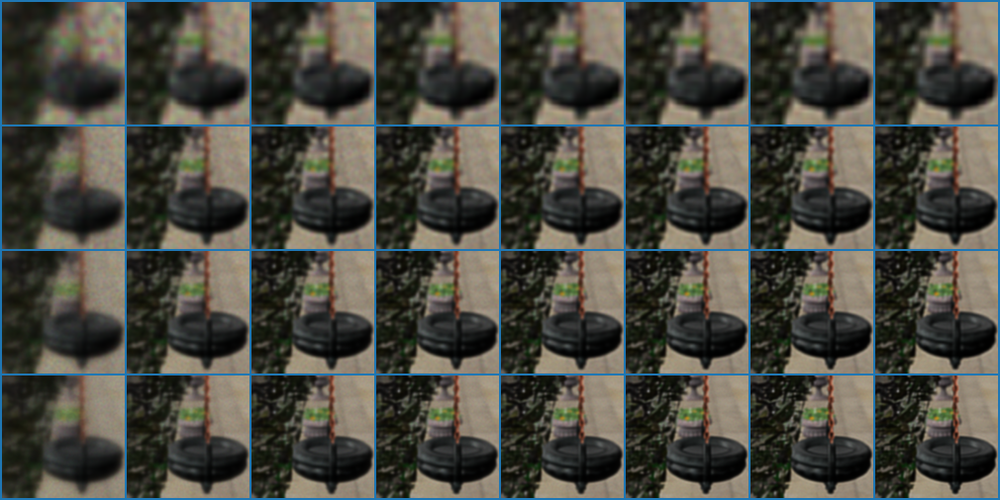

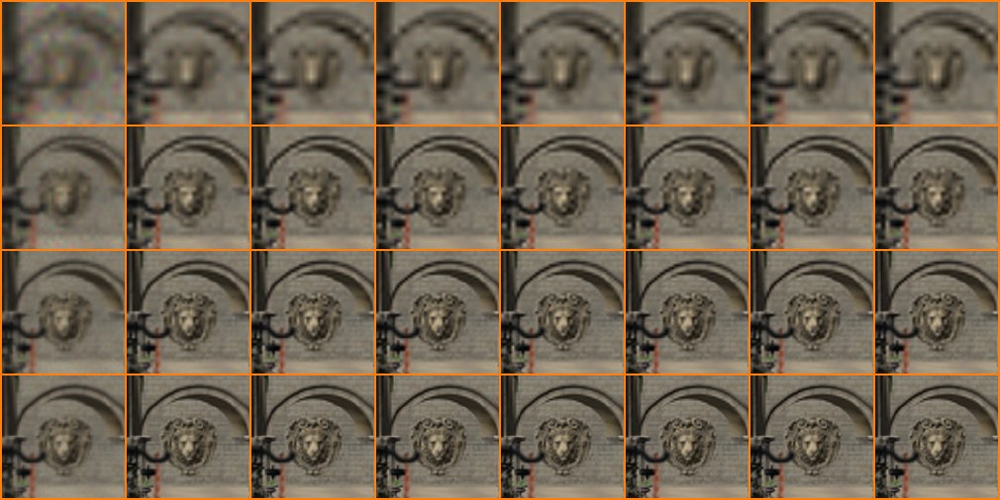

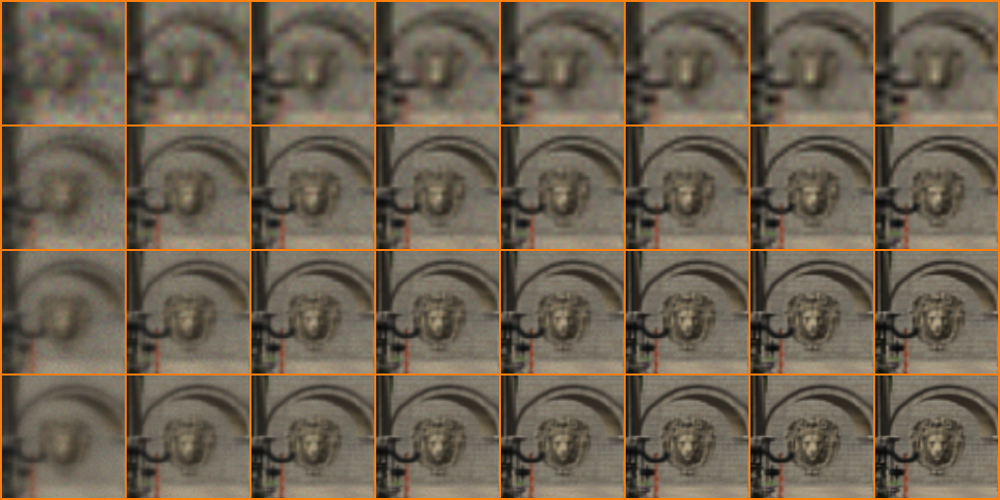

In [4]:
print('Rows: Resolution | Columns: Iterations')

img = Image.new(mode='RGB', size=(n_iters * (insert_size-border) + border, n_resolutions * (insert_size-border) + border), color=(255, 255, 255))

for scene_index in range(n_scenes):
    for depth_index in range(n_depths):
        for method_index in range(n_methods):
            for iter_index in range(n_iters):
                for resolution_index in range(n_resolutions):
                    img.paste(inserts[scene_index][resolution_index][depth_index][method_index][iter_index], (iter_index * (insert_size-border), resolution_index * (insert_size-border)))
            img.save('figures/multiter-inserts/{}-{}-{}.png'.format(scenes[scene_index], depths[depth_index], methods[method_index]))
            display(img)

Rows: Iterations | Columns: Resolution


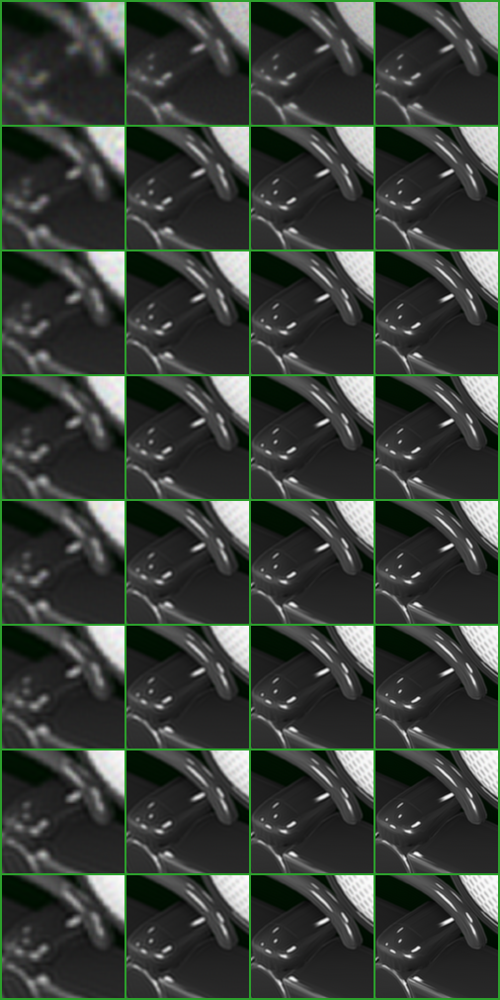

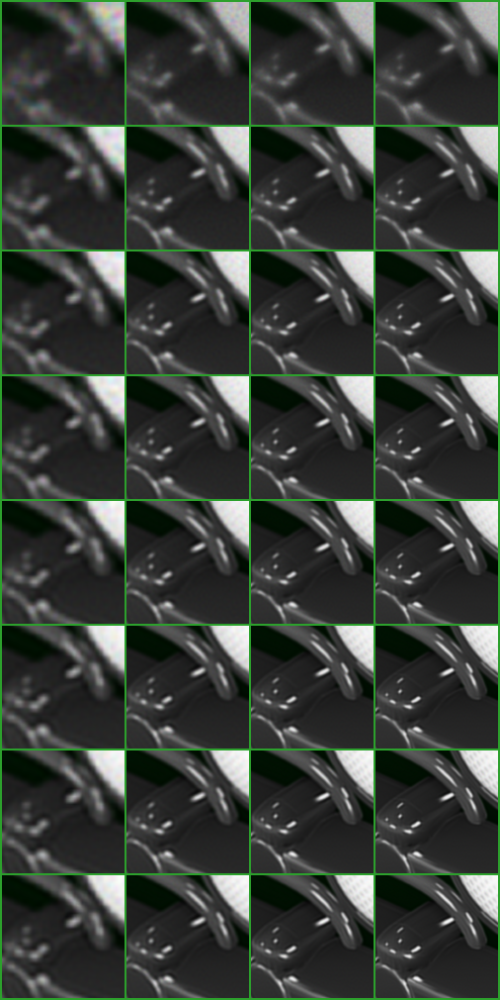

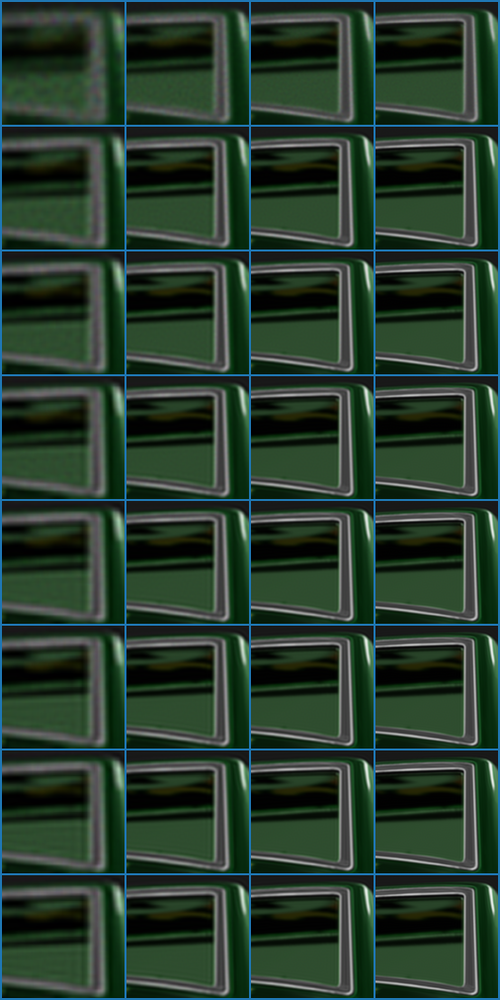

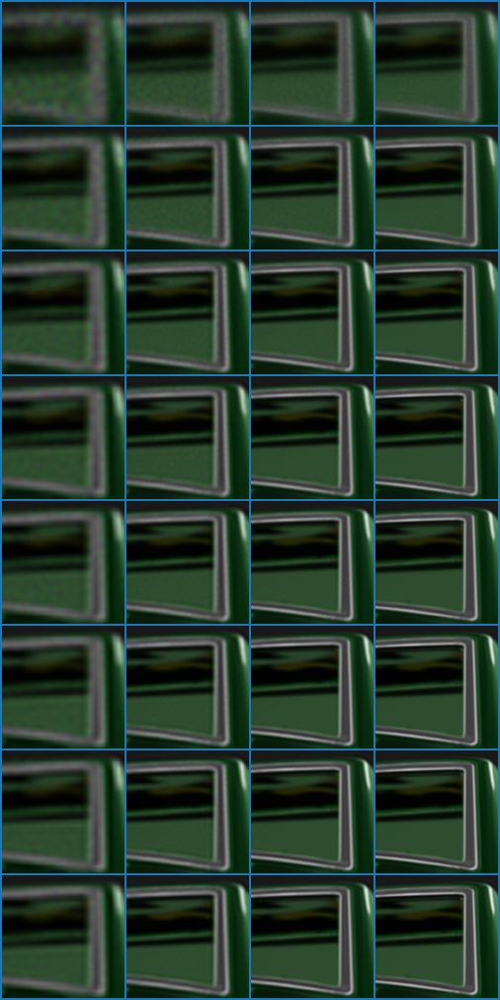

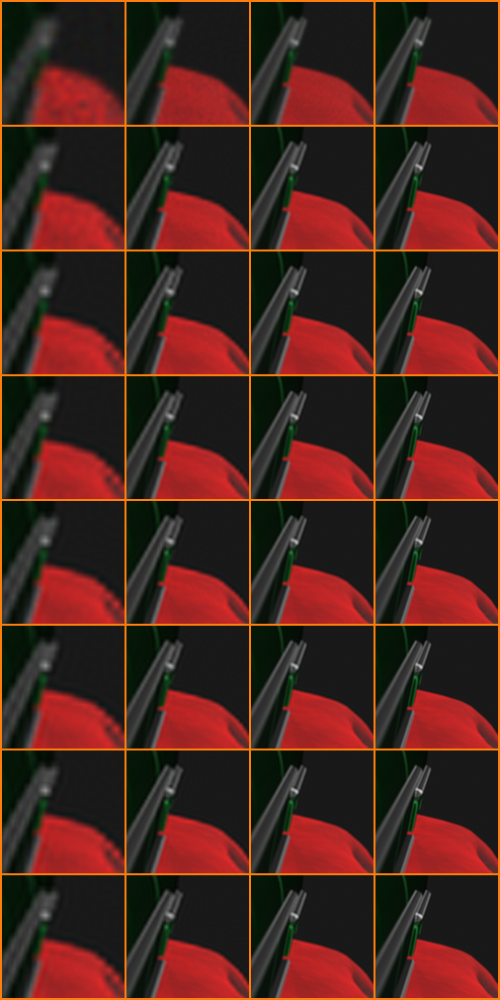

...

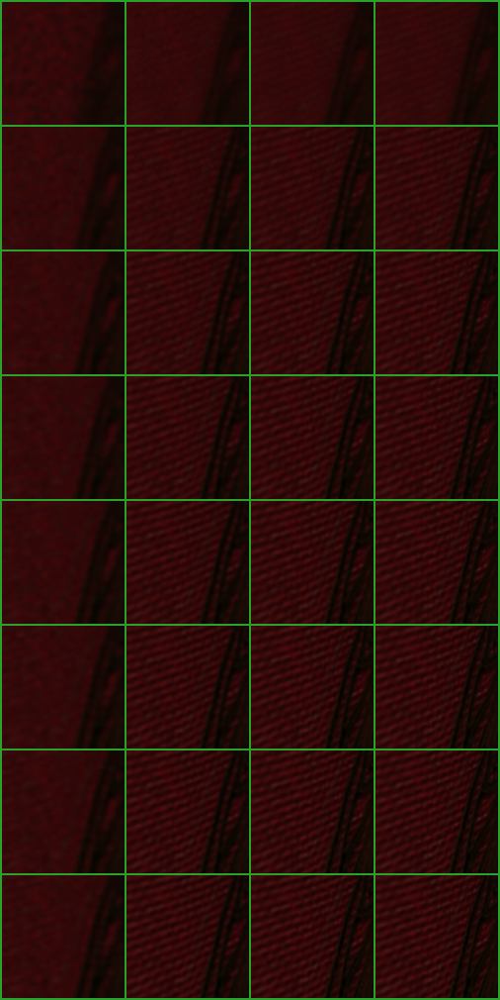

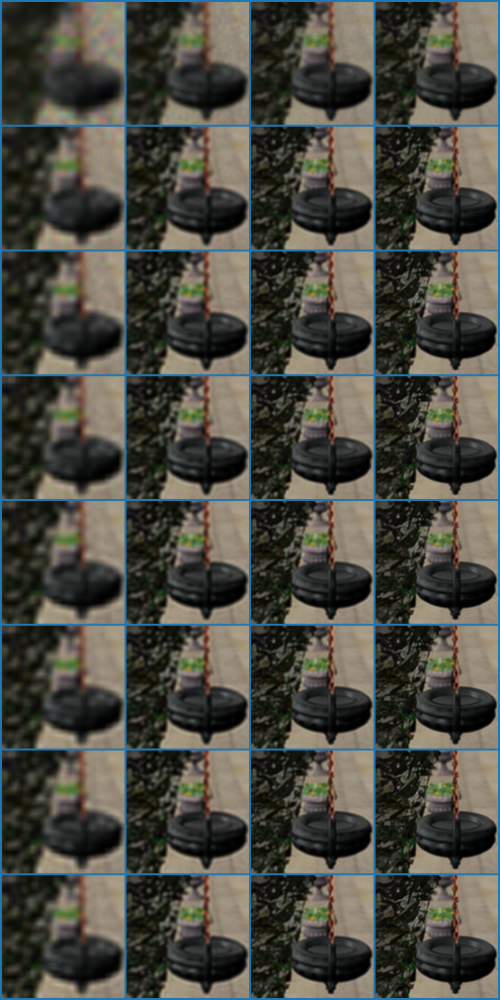

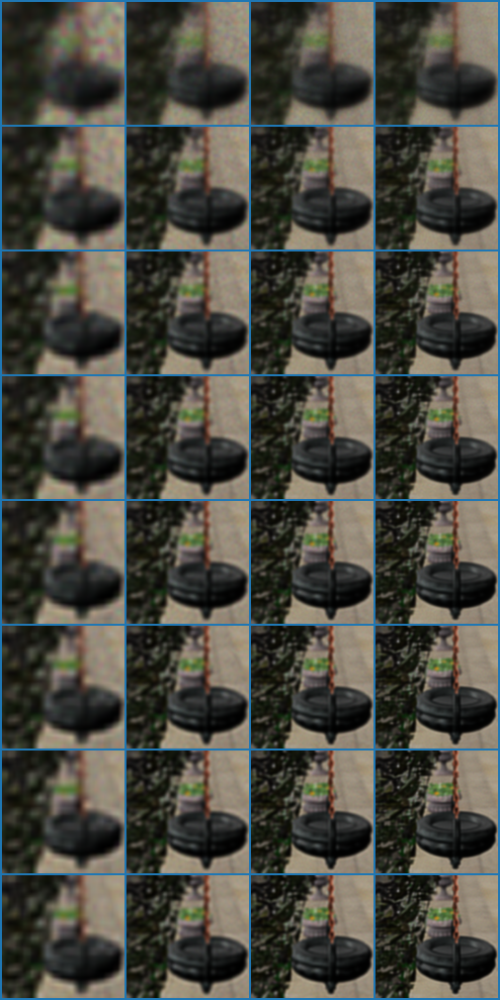

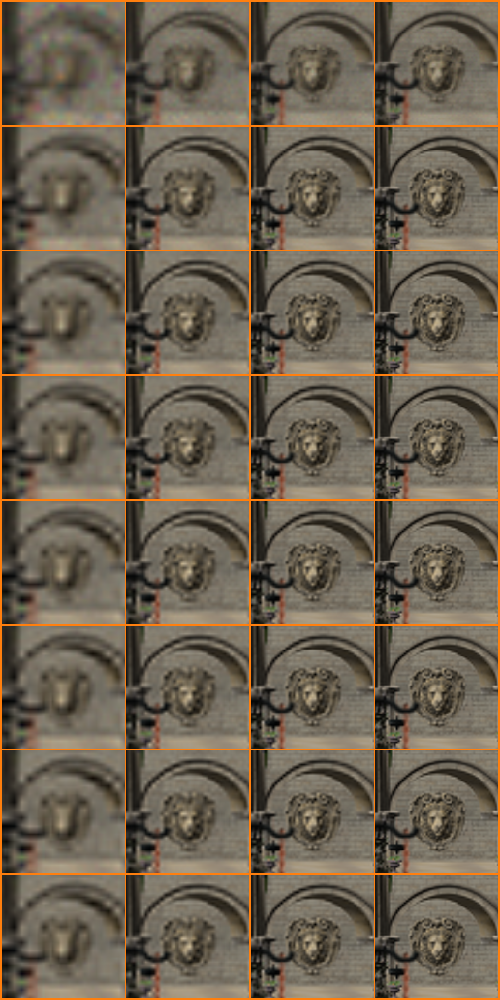

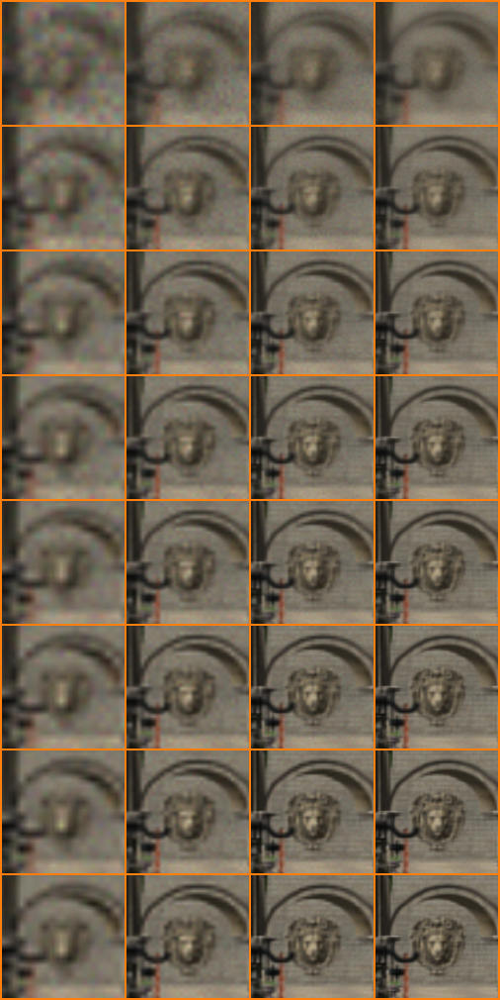

In [5]:
print('Rows: Iterations | Columns: Resolution')

img = Image.new(mode='RGB', size=(n_resolutions * (insert_size-border) + border, n_iters * (insert_size-border) + border), color=(255, 255, 255))

for scene_index in range(n_scenes):
    for depth_index in range(n_depths):
        for method_index in range(n_methods):
            for iter_index in range(n_iters):
                for resolution_index in range(n_resolutions):
                    img.paste(inserts[scene_index][resolution_index][depth_index][method_index][iter_index], (resolution_index * (insert_size-border), iter_index * (insert_size-border)))
            img.save('figures/multiter-inserts/{}-{}-{}_T.png'.format(scenes[scene_index], depths[depth_index], methods[method_index]))
            display(img)